In [ ]:
import librosa
import librosa.display
import matplotlib.pyplot as plt
import numpy as np
from IPython.display import Audio
from scipy.io import wavfile
import os
import pandas as pd
import random

In [ ]:
os.environ["CUDA_VISIBLE_DEVICES"] = "0"  # Set to a valid GPU index


# Grupo:
> André Guarnier De Mitri - 11395579 \
> Rui Emanuel Lima Vieira - 11810182

# 1) Identificação do Problema
Nosso objetivo é obter as porcentagens dos intrumentos musicais que compõe uma determinada musica através do uso de Spectogramas e Redes Neurais.

Dado um arquivo de audio que está armazenado no google drive, o usuário fornecerá o link desse arquivo para nossa página web, e como resultado nossa aplicação mostrará um gráfico de barras dizendo quais instrumentos compões aquela musica e a porcetagem de participação destes.

Nosso programa foi treinado para classificar os seguintes intrumentos: Cello, Clarinete, Flauta, Guitarra Acustica, Guitarra Elétrica, Orgão, Piano, Saxophone, Trombeta, Violino e Canto.

 ## ***Importante:*** Como nossa rede neural já está treinada e não é necessário repetir o treino, para usar a nossa aplicação basta rodar as células a partir da seção **4) Aplicação**.

**Fonte dos dados:**
https://zenodo.org/records/1290750#.WzCwSRyxXMU

## Carregando os dados

In [ ]:
# Labels e dicionário de labels
instrument_classes = ['cel', 'cla', 'flu', 'gac', 'gel', 'org', 'pia', 'sax', 'tru', 'vio', 'voi']
class_dict = {inst_class: idx for idx, inst_class in enumerate(instrument_classes)}

In [ ]:
# Obtendo o dataframe de treino com base nos arquivos locais
train_path = r"data/IRMAS-TrainingData"

def get_file_info(directory, instrument_class, class_number):
    file_paths = [os.path.join(directory, file) for file in os.listdir(directory) if file.endswith(".wav")]
    return pd.DataFrame({'class': [instrument_class] * len(file_paths),
                        'label': [class_number] * len(file_paths),
                        'path': file_paths})

dfs = []
# Coloca classe e label no dataframe
for i, instrument_class in enumerate(instrument_classes):
    class_path = os.path.join(train_path, instrument_class)
    dfs.append(get_file_info(class_path, instrument_class, i))

# Datafram e resultante
df_train = pd.concat(dfs, ignore_index=True)
df_train

,class,label,path
0,cel,0,data/IRMAS-TrainingData/cel/[cel][cla]0008__1.wav
1,cel,0,data/IRMAS-TrainingData/cel/[cel][jaz_blu]0013__1.wav
2,cel,0,data/IRMAS-TrainingData/cel/090__[cel][nod][cla]0024__3.wav
3,cel,0,data/IRMAS-TrainingData/cel/[cel][jaz_blu]0085__3.wav
4,cel,0,data/IRMAS-TrainingData/cel/[cel][pop_roc]0101__1.wav
...,...,...,...
6700,voi,10,data/IRMAS-TrainingData/voi/[voi][pop_roc]2538__1.wav
6701,voi,10,data/IRMAS-TrainingData/voi/017__[voi][dru][pop_roc]2320__3.wav
6702,voi,10,data/IRMAS-TrainingData/voi/238__[voi][nod][cou_fol]2418__3.wav
6703,voi,10,data/IRMAS-TrainingData/voi/043__[voi][dru][pop_roc]2476__3.wav


In [ ]:
import os
import pandas as pd

# Função que lê os arquivos locais e coloca os dados de teste e um dataframe
def get_test_file_info(directory, class_dict):
    dfs = []
    for filename in os.listdir(directory):
        if filename.endswith(".wav"):
            wav_path = os.path.join(directory, filename)
            txt_filename = filename.replace(".wav", ".txt")
            txt_path = os.path.join(directory, txt_filename)
            with open(txt_path, 'r') as txt_file:
                content = txt_file.read()
                class_labels = content.strip().split('\n')

                classes = []
                class_numbers = []

                with open(txt_path, 'r') as txt_file:
                    content = txt_file.read()
                    class_labels = content.strip().split('\t\n')
                    class_numbers = [class_dict[classe] for classe in class_labels]

                dfs.append(pd.DataFrame({
                    'class': [class_labels],
                    'label': [class_numbers],
                    'wav': [wav_path],
                    'path': [txt_path]
                }))

    return dfs

directory_path = 'data/IRMAS-TestingData-Part1/Part1/'
df_test1 = get_test_file_info(directory_path, class_dict)
df_test1 = pd.concat(df_test1, ignore_index=True)
df_test1

,class,label,wav,path
0,"[pia, sax]","[6, 7]",data/IRMAS-TestingData-Part1/Part1/01 - Roadgame-18.wav,data/IRMAS-TestingData-Part1/Part1/01 - Roadgame-18.txt
1,[pia],[6],data/IRMAS-TestingData-Part1/Part1/01. Flight Time-3.wav,data/IRMAS-TestingData-Part1/Part1/01. Flight Time-3.txt
2,[voi],[10],data/IRMAS-TestingData-Part1/Part1/00 - yazoo - dont go-9.wav,data/IRMAS-TestingData-Part1/Part1/00 - yazoo - dont go-9.txt
3,[pia],[6],data/IRMAS-TestingData-Part1/Part1/01 Just One Of Those Things-18.wav,data/IRMAS-TestingData-Part1/Part1/01 Just One Of Those Things-18.txt
4,"[pia, sax, tru]","[6, 7, 8]",data/IRMAS-TestingData-Part1/Part1/01 Don't Get Around Much Anymore-16.wav,data/IRMAS-TestingData-Part1/Part1/01 Don't Get Around Much Anymore-16.txt
...,...,...,...,...
802,[gel],[4],data/IRMAS-TestingData-Part1/Part1/01 - Airdrop-2.wav,data/IRMAS-TestingData-Part1/Part1/01 - Airdrop-2.txt
803,"[org, pia]","[5, 6]",data/IRMAS-TestingData-Part1/Part1/01. Another World-4.wav,data/IRMAS-TestingData-Part1/Part1/01. Another World-4.txt
804,[gac],[3],data/IRMAS-TestingData-Part1/Part1/01) Bert Jansch - Avocet-60.wav,data/IRMAS-TestingData-Part1/Part1/01) Bert Jansch - Avocet-60.txt
805,"[gel, voi]","[4, 10]",data/IRMAS-TestingData-Part1/Part1/01) Jeff Beck - Hi-Ho Silver Lining-1.wav,data/IRMAS-TestingData-Part1/Part1/01) Jeff Beck - Hi-Ho Silver Lining-1.txt


In [ ]:
directory_path = 'data/IRMAS-TestingData-Part2/Part2/'
df_test2 = get_test_file_info(directory_path, class_dict)
df_test2 = pd.concat(df_test2, ignore_index=True)
df_test2

,class,label,wav,path
0,[gac],[3],data/IRMAS-TestingData-Part2/Part2/Partido Alto-1.wav,data/IRMAS-TestingData-Part2/Part2/Partido Alto-1.txt
1,"[gac, voi]","[3, 10]",data/IRMAS-TestingData-Part2/Part2/kate bush - aerial - cd 2 - a sky of honey - 08 - nocturn-38.wav,data/IRMAS-TestingData-Part2/Part2/kate bush - aerial - cd 2 - a sky of honey - 08 - nocturn-38.txt
2,[voi],[10],data/IRMAS-TestingData-Part2/Part2/artificial intelligence - 08 -- autechre - the egg-5.wav,data/IRMAS-TestingData-Part2/Part2/artificial intelligence - 08 -- autechre - the egg-5.txt
3,[gel],[4],data/IRMAS-TestingData-Part2/Part2/Jaga Jazzist - Mikado-5.wav,data/IRMAS-TestingData-Part2/Part2/Jaga Jazzist - Mikado-5.txt
4,[voi],[10],data/IRMAS-TestingData-Part2/Part2/Gesualdo - Io tacero-6.wav,data/IRMAS-TestingData-Part2/Part2/Gesualdo - Io tacero-6.txt
...,...,...,...,...
1296,"[pia, voi]","[6, 10]",data/IRMAS-TestingData-Part2/Part2/Jelly Roll Morton - Honky Tonk Blues-14.wav,data/IRMAS-TestingData-Part2/Part2/Jelly Roll Morton - Honky Tonk Blues-14.txt
1297,[gel],[4],data/IRMAS-TestingData-Part2/Part2/tomahawk-rape_this_day-11.wav,data/IRMAS-TestingData-Part2/Part2/tomahawk-rape_this_day-11.txt
1298,[gel],[4],data/IRMAS-TestingData-Part2/Part2/21 La Lluna La Pruna _ Plou I Fa Sol _ Sol Solet-5.wav,data/IRMAS-TestingData-Part2/Part2/21 La Lluna La Pruna _ Plou I Fa Sol _ Sol Solet-5.txt
1299,"[gac, voi]","[3, 10]",data/IRMAS-TestingData-Part2/Part2/1992 - Blind Guardian - Somewhere Far Beyond - The Bard's Song (In The Forest)-3.wav,data/IRMAS-TestingData-Part2/Part2/1992 - Blind Guardian - Somewhere Far Beyond - The Bard's Song (In The Forest)-3.txt


In [ ]:
directory_path = 'data/IRMAS-TestingData-Part3/Part3/'
df_test3 = get_test_file_info(directory_path, class_dict)
df_test3 = pd.concat(df_test3, ignore_index=True)
df_test3

,class,label,wav,path
0,[pia],[6],data/IRMAS-TestingData-Part3/Part3/04.Mira - ANDREW HILL-6.wav,data/IRMAS-TestingData-Part3/Part3/04.Mira - ANDREW HILL-6.txt
1,[gac],[3],data/IRMAS-TestingData-Part3/Part3/07-My Romance-3.wav,data/IRMAS-TestingData-Part3/Part3/07-My Romance-3.txt
2,"[pia, voi]","[6, 10]",data/IRMAS-TestingData-Part3/Part3/02-the_theory_of_everything_part_2-6.wav,data/IRMAS-TestingData-Part3/Part3/02-the_theory_of_everything_part_2-6.txt
3,"[flu, gel, sax]","[2, 4, 7]",data/IRMAS-TestingData-Part3/Part3/12 What'll I Do - Bud Shank And Bob-9.wav,data/IRMAS-TestingData-Part3/Part3/12 What'll I Do - Bud Shank And Bob-9.txt
4,"[gel, pia]","[4, 6]",data/IRMAS-TestingData-Part3/Part3/03-I'll Be OK-4.wav,data/IRMAS-TestingData-Part3/Part3/03-I'll Be OK-4.txt
...,...,...,...,...
761,"[gac, gel]","[3, 4]","data/IRMAS-TestingData-Part3/Part3/03 - robert fripp, brian eno - evening star-25.wav","data/IRMAS-TestingData-Part3/Part3/03 - robert fripp, brian eno - evening star-25.txt"
762,"[gac, gel, voi]","[3, 4, 10]",data/IRMAS-TestingData-Part3/Part3/02 entangled-3.wav,data/IRMAS-TestingData-Part3/Part3/02 entangled-3.txt
763,[voi],[10],data/IRMAS-TestingData-Part3/Part3/06 - the human league - reproduction - empire state human-12.wav,data/IRMAS-TestingData-Part3/Part3/06 - the human league - reproduction - empire state human-12.txt
764,[cla],[1],"data/IRMAS-TestingData-Part3/Part3/08-Concerto in A major, K 219 -2- Adagio-3.wav","data/IRMAS-TestingData-Part3/Part3/08-Concerto in A major, K 219 -2- Adagio-3.txt"


## Distribuição das classes

In [ ]:
import plotly.express as px

fig = px.bar(df_train, x='class', color='class', title='Class Distribution', barmode='relative')
fig.update_traces(dict(marker_line_width=0))
fig.show()

Há algumas classes com menos amostras, esse desbalanceamento pode influenciar no treino.

## Exemplos: Mel's Spectogram e audio

In [ ]:
# Escolhendo um arquivo para cada exmplo
def generate_example_dict():
    file_example_dict = {}
    for cls in instrument_classes:
        file_name = df_train.loc[df_train['class'] == cls, 'path'].values[random.randint(0, 20)]
        file_example_dict[cls] = file_name
    return file_example_dict
file_example_dict = generate_example_dict()
file_example_dict

{'cel': 'data/IRMAS-TrainingData/cel/[cel][cla]0003__1.wav',
 'cla': 'data/IRMAS-TrainingData/cla/[cla][jaz_blu]0275__2.wav',
 'flu': 'data/IRMAS-TrainingData/flu/[flu][jaz_blu]0500__1.wav',
 'gac': 'data/IRMAS-TrainingData/gac/[gac][pop_roc]0720__1.wav',
 'gel': 'data/IRMAS-TrainingData/gel/[gel][pop_roc]1022__1.wav',
 'org': 'data/IRMAS-TrainingData/org/[org][jaz_blu]1108__3.wav',
 'pia': 'data/IRMAS-TrainingData/pia/[pia][jaz_blu]1462__2.wav',
 'sax': 'data/IRMAS-TrainingData/sax/058__[sax][nod][cla]1662__3.wav',
 'tru': 'data/IRMAS-TrainingData/tru/[tru][jaz_blu]1905__1.wav',
 'vio': 'data/IRMAS-TrainingData/vio/120__[vio][nod][cla]2181__2.wav',
 'voi': 'data/IRMAS-TrainingData/voi/[voi][pop_roc]2547__1.wav'}

In [ ]:
# Plotando um exemplo de cada classe
def plot_example(file_example_dict, cls):
    # Spectogram
    y, sr = librosa.load(file_example_dict[cls])
    spec = np.abs(librosa.stft(y, hop_length=512,))
    spec = librosa.amplitude_to_db(spec, ref=np.max)
    librosa.display.specshow(spec, sr=sr, x_axis='time', y_axis='log');

    # Spectogram Plot
    plt.colorbar(format='%+2.0f dB');
    plt.title(f'Spectrogram ({cls})');

    # Audio Example
    aud = wavfile.read(file_example_dict[cls])
    # Separete the object elements
    framerate = aud[0]
    sounddata = aud[1]
    time      = np.arange(0,len(sounddata))/framerate

    # Show information about the object
    print('Sample rate:',framerate,'Hz')
    print('Lenght', len(sounddata))
    print('Total time:',len(sounddata)/framerate,'s')

    # Generate a player for mono sound
    return Audio(sounddata.T,rate=framerate)

### Cello

Sample rate: 44100 Hz
Lenght 132299
Total time: 2.9999773242630385 s


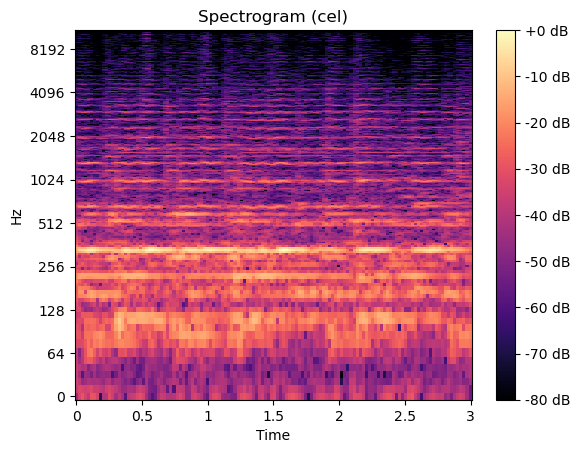

In [ ]:
plot_example(file_example_dict, instrument_classes[0])

### Clarinet

Sample rate: 44100 Hz
Lenght 132299
Total time: 2.9999773242630385 s


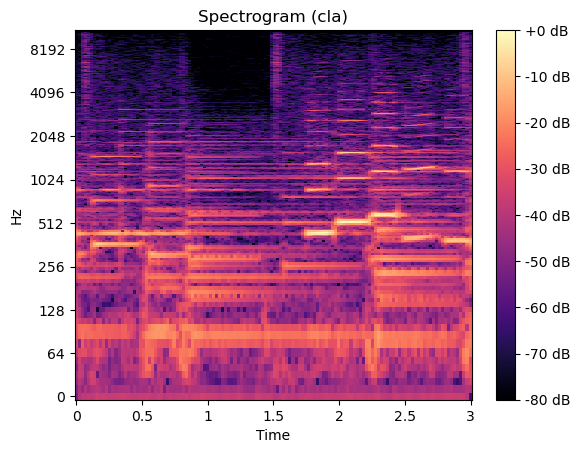

In [ ]:
plot_example(file_example_dict, instrument_classes[1])

### Flute

Sample rate: 44100 Hz
Lenght 132299
Total time: 2.9999773242630385 s


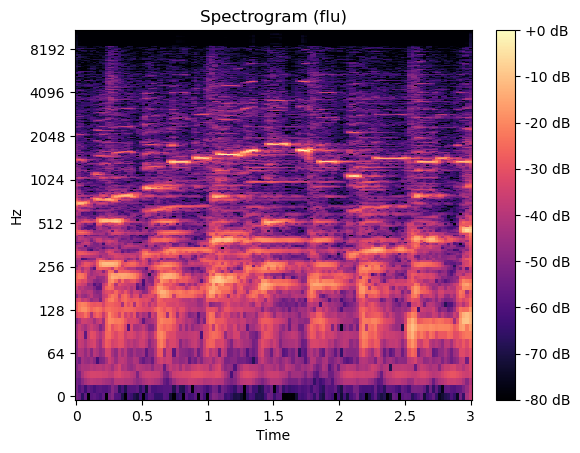

In [ ]:
plot_example(file_example_dict, instrument_classes[2])

### Acoustic Guitar

Sample rate: 44100 Hz
Lenght 132299
Total time: 2.9999773242630385 s


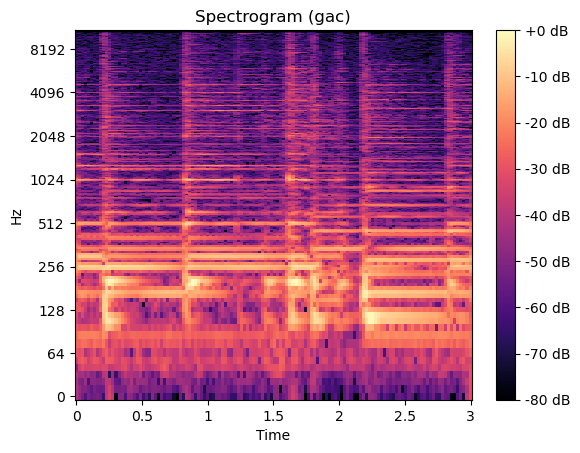

In [ ]:
plot_example(file_example_dict, instrument_classes[3])

### Electric Guitar

Sample rate: 44100 Hz
Lenght 132299
Total time: 2.9999773242630385 s


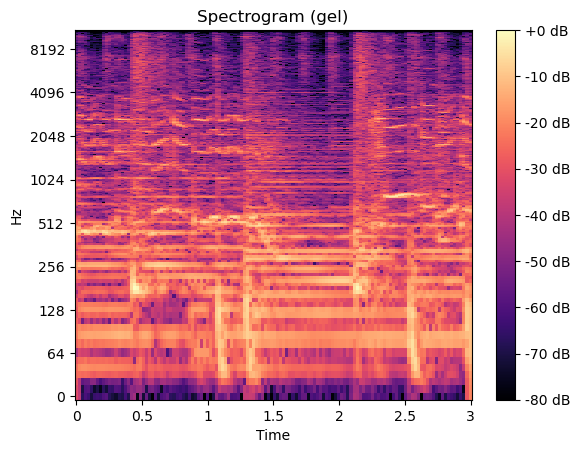

In [ ]:
plot_example(file_example_dict, instrument_classes[4])

### Organ

Sample rate: 44100 Hz
Lenght 132299
Total time: 2.9999773242630385 s


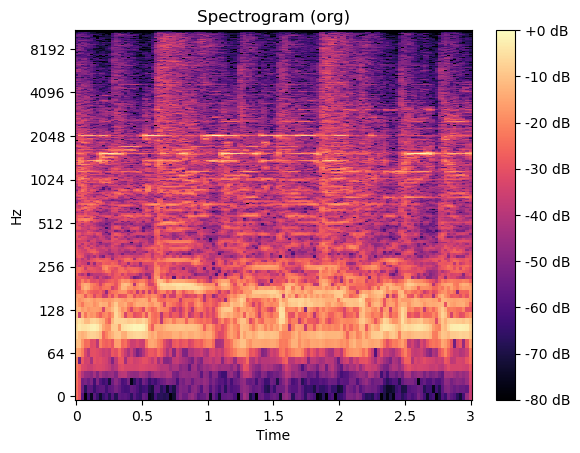

In [ ]:
plot_example(file_example_dict, instrument_classes[5])

### Piano

Sample rate: 44100 Hz
Lenght 132299
Total time: 2.9999773242630385 s


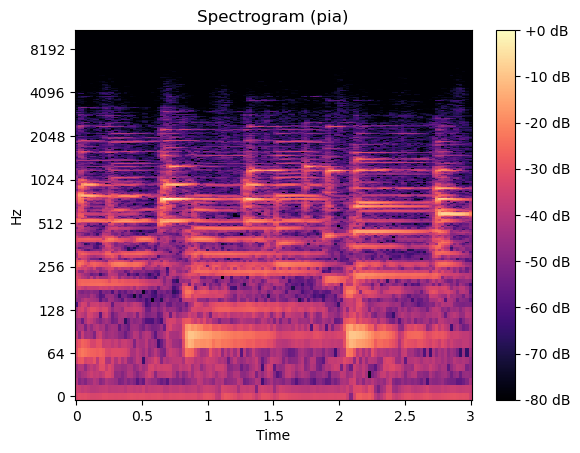

In [ ]:
plot_example(file_example_dict, instrument_classes[6])

### Saxophone

Sample rate: 44100 Hz
Lenght 132299
Total time: 2.9999773242630385 s


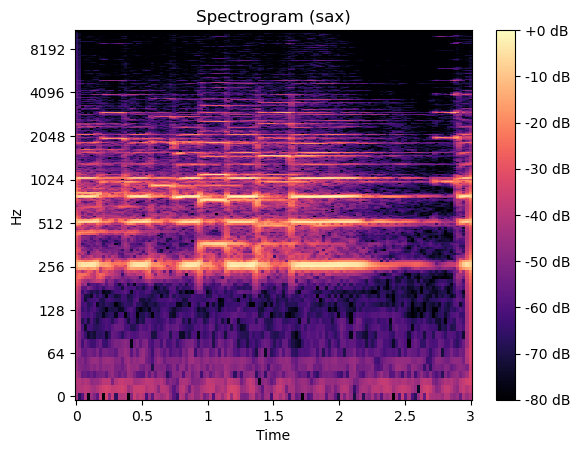

In [ ]:
plot_example(file_example_dict, instrument_classes[7])

### Trumpet

Sample rate: 44100 Hz
Lenght 132299
Total time: 2.9999773242630385 s


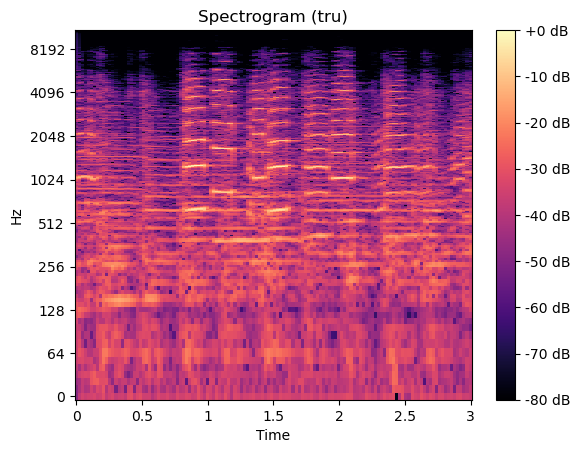

In [ ]:
plot_example(file_example_dict, instrument_classes[8])

### Violin

Sample rate: 44100 Hz
Lenght 132299
Total time: 2.9999773242630385 s


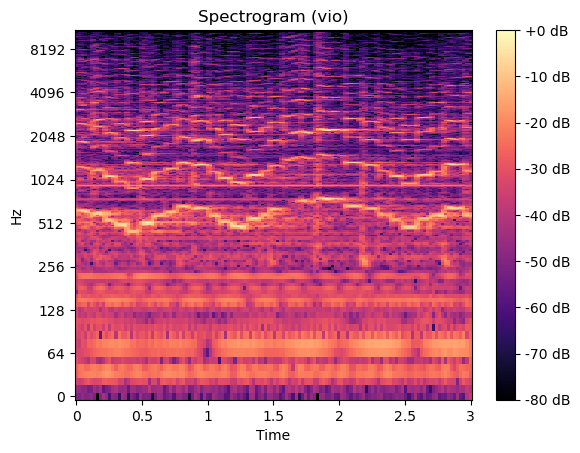

In [ ]:
plot_example(file_example_dict, instrument_classes[9])

### Singing Voice

Sample rate: 44100 Hz
Lenght 132299
Total time: 2.9999773242630385 s


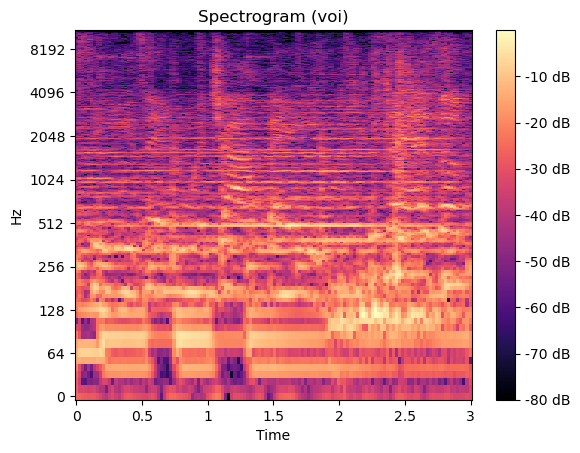

In [ ]:
plot_example(file_example_dict, instrument_classes[10])

# 2) Pré Processamento
## Preparação dos para treinamento do modelo

## Função que obtem Normalized Mel Spectogram

In [ ]:
import librosa

def get_mel_spectrogram(file_path, n_fft=2048, hop_length=512, n_mels=128):
    # print(file_path)
    y, sr = librosa.load(file_path) # Load audio file
    normalized_y = librosa.util.normalize(y) # Normalize between -1 and 1

    # Generate mel scaled filterbanks
    mel = librosa.feature.melspectrogram(y=normalized_y, sr=sr, n_mels=n_mels)

    # Convert sound intensity to log amplitude:
    mel_db = librosa.amplitude_to_db(abs(mel))

    # Normalize between -1 and 1
    normalized_mel = librosa.util.normalize(mel_db)

    return normalized_mel

## Aplica Mel Spectogram no df
retorna um array com o X, y e numero maximo de frames

In [ ]:
# Prepara os dados de TREINO
def prepare_data_train(df):
    features = []
    labels = []
    frames_max = 0
    counter = 0
    n_mels=40
    for index, (cls, class_label, path) in df.iterrows():
        # print(file_path)
        mels = get_mel_spectrogram(path, 0, n_mels=n_mels)

        # Save current frame count
        num_frames = mels.shape[1]

        # Add row (feature / label)
        features.append(mels)
        labels.append(class_label)

        # Update frames maximum
        if (num_frames > frames_max):
            frames_max = num_frames
    return features, labels, frames_max

In [ ]:
# Prepara os dados de TESTE
def prepare_data_test(df):
    features = []
    labels = []
    frames_max = 0
    counter = 0
    n_mels=40
    for index, (cls, class_label, path_wav, path_txt) in df.iterrows():
        # print(file_path)
        mels = get_mel_spectrogram(path_wav, 0, n_mels=n_mels)

        # Save current frame count
        num_frames = mels.shape[1]

        # Add row (feature / label)
        features.append(mels)
        labels.append(class_label)

        # Update frames maximum
        if (num_frames > frames_max):
            frames_max = num_frames
    return features, labels, frames_max

In [ ]:
X, y, frames_max = prepare_data_train(df_train)

data/IRMAS-TrainingData/cel/[cel][cla]0008__1.wav
data/IRMAS-TrainingData/cel/[cel][jaz_blu]0013__1.wav
data/IRMAS-TrainingData/cel/090__[cel][nod][cla]0024__3.wav
data/IRMAS-TrainingData/cel/[cel][jaz_blu]0085__3.wav
data/IRMAS-TrainingData/cel/[cel][pop_roc]0101__1.wav
data/IRMAS-TrainingData/cel/[cel][cla]0077__1.wav
data/IRMAS-TrainingData/cel/[cel][cla]0112__1.wav
data/IRMAS-TrainingData/cel/[cel][pop_roc]0136__2.wav
data/IRMAS-TrainingData/cel/119__[cel][nod][cla]0057__1.wav
data/IRMAS-TrainingData/cel/[cel][cla]0076__1.wav
data/IRMAS-TrainingData/cel/[cel][cla]0003__2.wav
data/IRMAS-TrainingData/cel/075__[cel][nod][cla]0021__1.wav
data/IRMAS-TrainingData/cel/[cel][jaz_blu]0086__1.wav
data/IRMAS-TrainingData/cel/[cel][cla]0003__1.wav
data/IRMAS-TrainingData/cel/[cel][pop_roc]0137__1.wav
data/IRMAS-TrainingData/cel/[cel][cla]0076__3.wav
data/IRMAS-TrainingData/cel/042__[cel][nod][cla]0042__1.wav
data/IRMAS-TrainingData/cel/088__[cel][nod][cla]0044__1.wav
data/IRMAS-TrainingData/ce

## Informações dos Maiores e Menores arquivos de audio

### Maior

In [ ]:
# Maior audio TRAIN
maior = 0
for i in range(len(X)):
    leng = X[i].shape[1]
    if leng > maior:
        maior = leng
        j = i
aud = wavfile.read(df_train.loc[j]['path'])
print(df_train.loc[j]['path'])
# Separete the object elements
framerate = aud[0]
sounddata = aud[1]
time      = np.arange(0,len(sounddata))/framerate

# Show information about the object
print('Sample rate:',framerate,'Hz')
print('Lenght', len(sounddata))
print('Total time:',len(sounddata)/framerate,'s')
print()
print('Array len mel spec:', X[j].shape)

data/IRMAS-TrainingData/cel/[cel][cla]0008__1.wav
Sample rate: 44100 Hz
Lenght 132299
Total time: 2.9999773242630385 s

Array len mel spec: (40, 130)


### Menor

In [ ]:
# Menor audio TRAIN
menor = 5516
for i in range(len(X)):
    leng = X[i].shape[1]
    if leng < menor:
        menor = leng
        k = i

aud = wavfile.read(df_train.loc[k]['path'])
print(df_train.loc[k]['path'])
# Separete the object elements
framerate = aud[0]
sounddata = aud[1]
time      = np.arange(0,len(sounddata))/framerate

# Show information about the object
print('Sample rate:',framerate,'Hz')
print('Lenght', len(sounddata))
print('Total time:',len(sounddata)/framerate,'s')
print()
print('Array len mel spec:', X[k].shape)

data/IRMAS-TrainingData/cel/[cel][cla]0008__1.wav
Sample rate: 44100 Hz
Lenght 132299
Total time: 2.9999773242630385 s

Array len mel spec: (40, 130)


**Não há diferneça entre o tamanho dos arquivos!!!**

## Adicionando Padding

In [ ]:
# Adiciona padding após a aplicação do Mel Spectogram
def add_padding(features, max_padding=100):
    padded = []
    for i in range(len(features)):
        px = features[i]
        size = len(px[0])
        # Padding deixando o audio no centro
        if (size < max_padding):
            xDiff = max_padding - size
            xLeft = xDiff//2
            xRight = xDiff-xLeft
            px = np.pad(px, pad_width=((0,0), (xLeft, xRight)), mode='constant')

        padded.append(px)

    return padded

In [ ]:
# Formato dos dados
X = add_padding(X, frames_max)
X = np.array(X)
print(X.shape, '---', len(y))

(6705, 40, 130) --- 6705


## Carregando e Salvando as matrizes de treino e teste

In [ ]:
import librosa
import librosa.display
import matplotlib.pyplot as plt
import numpy as np
from IPython.display import Audio
from scipy.io import wavfile
import os
import pandas as pd

In [ ]:
import pickle

def save_data_pickle(X, y):
    with open('Xy_data.pkl', 'wb') as f:
        pickle.dump((X, y), f)
    print("Dados SALVOS em Xy_data.pkl")

def load_data_pickle():
    with open('Xy_data.pkl', 'rb') as f:
        loaded_X, loaded_y = pickle.load(f)
    print("Dados CARREGADOS de Xy_data.pkl")
    return loaded_X, loaded_y

### Salvando as Matrizes

In [ ]:
# save_data_pickle(X, y)

### Carregando as Matrizes

In [ ]:
# url = 'https://drive.google.com/file/d/12deI9ukDtZ7UvVW3hsmoGLAiYPhpga8O/view?usp=sharing'
# url = 'https://drive.google.com/uc?id=' + url.split('/')[-2]
# gdown.download(url)
# X, y = load_data_pickle()

Dados CARREGADOS de Xy_data.pkl


# 3) Extração de Padrões - Usando uma LSTM

In [ ]:
!pip install pytorch_lightning --quiet
!pip install pyngrok --quiet

## Treinamento do modelo

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import torch
from torch import nn
import pytorch_lightning as pl
from torch.utils.data import Dataset, DataLoader
from sklearn.model_selection import train_test_split
from pytorch_lightning.callbacks import ModelCheckpoint, EarlyStopping
from sklearn.metrics import f1_score

# Dataset do dataloader
class AudioDataset(Dataset):
    def __init__(self, X, y):
        self.X = X
        self.y = y

    def __len__(self):
        return len(self.X)

    def __getitem__(self, index):
        return torch.Tensor(self.X[index]), torch.LongTensor([self.y[index]])

# LSTM Model
class LSTMModel(pl.LightningModule):
    def __init__(self, input_size, hidden_size, num_layers, num_classes):
        super(LSTMModel, self).__init__()
        self.lstm = nn.LSTM(input_size=input_size, hidden_size=hidden_size, num_layers=num_layers, batch_first=True)
        self.fc = nn.Linear(hidden_size, num_classes)

    def forward(self, x):
        out, _ = self.lstm(x)
        out = self.fc(out[:, -1, :])
        return out

    def training_step(self, batch, batch_idx):
        x, y = batch
        y_hat = self(x)
        loss = nn.CrossEntropyLoss()(y_hat, y.squeeze())
        self.log("train_loss", loss, on_epoch=True)
        return loss

    def validation_step(self, batch, batch_idx):
        x, y = batch
        y_hat = self(x)
        loss = nn.CrossEntropyLoss()(y_hat, y.squeeze())
        preds = torch.argmax(y_hat, dim=1)
        f1 = f1_score(y.squeeze().cpu().numpy(), preds.cpu().numpy(), average='weighted')
        self.log("val_loss", loss, prog_bar=False, on_epoch=True)
        self.log("val_f1", f1, prog_bar=False, on_epoch=True)
        return loss

    def test_step(self, batch, batch_idx):
        x, y = batch
        y_hat = self(x)
        loss = nn.CrossEntropyLoss()(y_hat, y.squeeze())
        preds = torch.argmax(y_hat, dim=1)
        f1 = f1_score(y.squeeze().cpu().numpy(), preds.cpu().numpy(), average='weighted')
        self.log("test_loss", loss, on_epoch=True, logger=True)
        self.log("test_f1", f1, on_epoch=True, logger=True)
        return loss

    def configure_optimizers(self):
        return torch.optim.Adam(self.parameters(), lr=0.001)

#--------- Realizando 5 experimentos ------------------------------------------ #
for i in range(5):
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)
    X_test, X_val, y_test, y_val = train_test_split(X_test, y_test, test_size=0.5)

    # Datasets
    train_dataset = AudioDataset(X_train, y_train)
    val_dataset = AudioDataset(X_val, y_val)
    test_dataset = AudioDataset(X_test, y_test)

    # Dataloaders
    train_dataloader = DataLoader(train_dataset, batch_size=32, shuffle=True, num_workers=2)
    val_dataloader = DataLoader(val_dataset, batch_size=32, num_workers=2)
    test_dataloader = DataLoader(test_dataset, batch_size=32, num_workers=2)

    # Modelo
    model = LSTMModel(input_size=130, hidden_size=64, num_layers=2, num_classes=11)

    # Checkpoint - Salva o melhor modelo
    checkpoint_callback = ModelCheckpoint(
    monitor='val_f1',
    dirpath='models/',
    filename='LSTM-{epoch:02d}-{val_f1:.2f}',
    save_top_k=1,
    mode='max'
    )

    # Treino
    trainer = pl.Trainer(max_epochs=50, callbacks=[checkpoint_callback])
    trainer.fit(model, train_dataloader, val_dataloader)

## Visualizando as Métricas

In [ ]:
%reload_ext tensorboard
%tensorboard --logdir=lightning_logs/

<IPython.core.display.Javascript object>

## Exemplos de Classificação Correta

Arquivo  090__[cel][nod][cla]0024__3.wav
Y real:  0  Cello
Y predito:  0 Cello


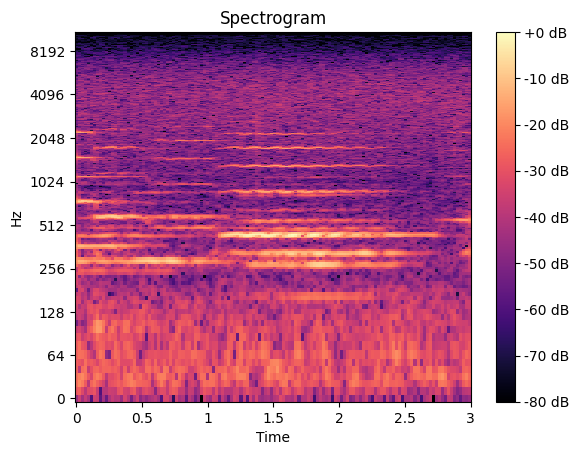

In [ ]:
# Loop para encontrar classificação Correta
i = 0
for X_new, y_real in zip(X, y):
  X_new_tensor = torch.Tensor(X_new).unsqueeze(0)
  y_hat = model(X_new_tensor)
  y_hat = torch.argmax(y_hat, dim=1).item()
  i+= 1
  if (y_hat == y_real):
    print("Arquivo ", df_train['path'][i])
    print("Y real: ", y_real, ' Cello')
    print("Y predito: ", y_hat, 'Cello')
    break

# Carrega o arquivo de audio
y_spec, sr = librosa.load(df_train['path'][i])
spec = np.abs(librosa.stft(y_spec, hop_length=512,))
spec = librosa.amplitude_to_db(spec, ref=np.max)
librosa.display.specshow(spec, sr=sr, x_axis='time', y_axis='log');

# Spectogram Plot
plt.colorbar(format='%+2.0f dB');
plt.title(f'Spectrogram');

# Audio
aud = wavfile.read(df_train['path'][i])
framerate = aud[0]
sounddata = aud[1]
time      = np.arange(0,len(sounddata))/framerate

# Player do audio
Audio(sounddata.T,rate=framerate)

## Exemplo de classficação Incorreta

Arquivo  [cel][cla]0008__1.wav
Y real:  0  Cello
Y predito:  9  Violin


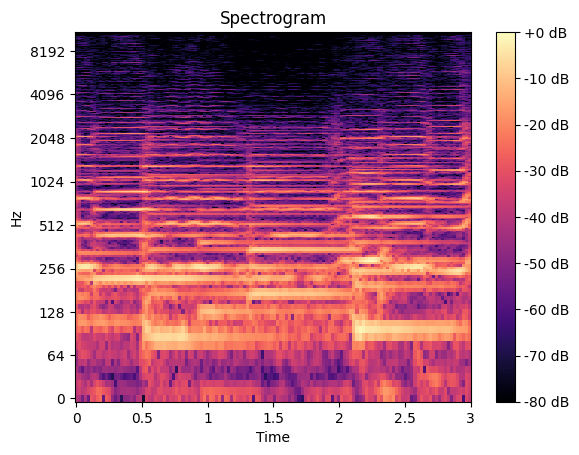

In [ ]:
# Loop para encontrar classificação Incorreta
i = 0
for X_new, y_real in zip(X, y):
  X_new_tensor = torch.Tensor(X_new).unsqueeze(0)
  y_hat = model(X_new_tensor)
  y_hat = torch.argmax(y_hat, dim=1).item()
  i+= 1
  if (y_hat != y_real):
    print("Arquivo ", df_train['path'][i])
    print("Y real: ", y_real, ' Cello')
    print("Y predito: ", y_hat, ' Violin')
    break

# Carrega o arquivo de audio
y_spec, sr = librosa.load(df_train['path'][i])
spec = np.abs(librosa.stft(y_spec, hop_length=512,))
spec = librosa.amplitude_to_db(spec, ref=np.max)
librosa.display.specshow(spec, sr=sr, x_axis='time', y_axis='log');

# Spectogram Plot
plt.colorbar(format='%+2.0f dB');
plt.title(f'Spectrogram');

# Audio
aud = wavfile.read(df_train['path'][i])
framerate = aud[0]
sounddata = aud[1]
time      = np.arange(0,len(sounddata))/framerate

# Player do audio
Audio(sounddata.T,rate=framerate)

# 4) Aplicação do Conhecimento - Carregando modelo treinado
***ATENÇÃO:*** Para rodar a aplicação basta rodar dessa parte para baixo



Aqui foi necessário repetir alguns dos códigos já apresentados acima para que seja possivel rodar apenas essa seção

In [ ]:
!pip install pytorch_lightning --quiet
!pip install pyngrok --quiet

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import librosa
import librosa.display
from IPython.display import Audio
from scipy.io import wavfile
import os
import threading
import torch
from torch import nn
from pyngrok import ngrok
from flask import Flask, request, Response, render_template_string, render_template
import gdown
import shutil
import plotly.offline
import pytorch_lightning as pl
from torch.utils.data import Dataset, DataLoader
from sklearn.model_selection import train_test_split
from pytorch_lightning.callbacks import ModelCheckpoint, EarlyStopping
from sklearn.metrics import f1_score
import plotly.express as px

## Rede Neural LSTM

In [ ]:
# Dataset do dataloader
class AudioDataset(Dataset):
    def __init__(self, X, y):
        self.X = X
        self.y = y

    def __len__(self):
        return len(self.X)

    def __getitem__(self, index):
        return torch.Tensor(self.X[index]), torch.LongTensor([self.y[index]])

# LSTM Model
class LSTMModel(pl.LightningModule):
    def __init__(self, input_size, hidden_size, num_layers, num_classes):
        super(LSTMModel, self).__init__()
        self.lstm = nn.LSTM(input_size=input_size, hidden_size=hidden_size, num_layers=num_layers, batch_first=True)
        self.fc = nn.Linear(hidden_size, num_classes)

    def forward(self, x):
        out, _ = self.lstm(x)
        out = self.fc(out[:, -1, :])
        return out

    def training_step(self, batch, batch_idx):
        x, y = batch
        y_hat = self(x)
        loss = nn.CrossEntropyLoss()(y_hat, y.squeeze())
        self.log("train_loss", loss, on_epoch=True)
        return loss

    def validation_step(self, batch, batch_idx):
        x, y = batch
        y_hat = self(x)
        loss = nn.CrossEntropyLoss()(y_hat, y.squeeze())
        preds = torch.argmax(y_hat, dim=1)
        f1 = f1_score(y.squeeze().cpu().numpy(), preds.cpu().numpy(), average='weighted')
        self.log("val_loss", loss, prog_bar=False, on_epoch=True)
        self.log("val_f1", f1, prog_bar=False, on_epoch=True)
        return loss

    def test_step(self, batch, batch_idx):
        x, y = batch
        y_hat = self(x)
        loss = nn.CrossEntropyLoss()(y_hat, y.squeeze())
        preds = torch.argmax(y_hat, dim=1)
        f1 = f1_score(y.squeeze().cpu().numpy(), preds.cpu().numpy(), average='weighted')
        self.log("test_loss", loss, on_epoch=True, logger=True)
        self.log("test_f1", f1, on_epoch=True, logger=True)
        return loss

    def configure_optimizers(self):
        return torch.optim.Adam(self.parameters(), lr=0.001)

## Carrega a rede já treinada

In [ ]:
# Baixa os pesos da Rede
url = 'https://drive.google.com/file/d/1ZeSdzStnkYJqR3Oc7pdQQ_5UKGrzCSgb/view?usp=sharing'
url = 'https://drive.google.com/uc?id=' + url.split('/')[-2]
gdown.download(url)

# Carrega a rede
best_model_path = "LSTM_best.ckpt"
model = LSTMModel(input_size=130, hidden_size=64, num_layers=2, num_classes=11)
checkpoint = torch.load(best_model_path)
model.load_state_dict(checkpoint['state_dict'])

Downloading...
From: https://drive.google.com/uc?id=1ZeSdzStnkYJqR3Oc7pdQQ_5UKGrzCSgb
To: /content/LSTM_best.ckpt
100%|██████████| 1.02M/1.02M [00:00<00:00, 86.0MB/s]


<All keys matched successfully>

## Gera HTML
Gera o HTML responsavel pelo plot do gráfico após a inserção de um link

In [ ]:
def plot_classes(pred_list):
    # Mapeando as classes
    class_mapping = {0: 'cello', 1: 'clarinet', 2: 'flute', 3: 'acoustic guitar', 4: 'electric guitar', 5: 'organ', 6: 'piano', 7: 'saxophone', 8: 'trumpet', 9: 'violin', 10: 'singing voice'}
    class_names = [class_mapping[label] for label in pred_list]

    # Porcentagem
    class_counts = pd.Series(class_names).value_counts().sort_index()
    total_samples = len(pred_list)
    class_percentages = (class_counts / total_samples) * 100

    # Dataframe
    df = pd.DataFrame({'Class': class_counts.index, 'Percentage': class_percentages.values})
    fig = px.bar(df, x='Class', y='Percentage', color='Class', labels={'Class': 'Instrument Class', 'Percentage': 'Percentage'},
                 title='Class Distribution (Percentage)')

    # Todas as classes
    # fig.update_xaxes(tickmode='array', tickvals=list(range(len(class_counts))), ticktext=list(class_mapping.values()))
    fig.update_yaxes(range=[0, 100])

    return fig


def generate_result_html(plot_div):
    html_content = f'''
    <!DOCTYPE html>
    <html lang="en">
    <head>
        <meta charset="UTF-8">
        <meta http-equiv="X-UA-Compatible" content="IE=edge">
        <meta name="viewport" content="width=device-width, initial-scale=1.0">
        <title>Result</title>
        <script src="https://cdn.plot.ly/plotly-latest.min.js"></script>
        <link rel="stylesheet" href="https://cdn.jsdelivr.net/npm/bootstrap@5.3.0/dist/css/bootstrap.min.css">
    </head>
    <body>
        <div class="container mt-5">
            <h2 class="mb-4">Coloque o Google Drive Link para Download do Audio</h2>
            <p class="lead">Exemplo Real: <strong>https://drive.google.com/file/d/1Uh21aqM5SPqvaQnIhuJOnFmxOe1odaPz/view?usp=sharing</strong></p>
            <br></br>
            <p class="lead">Exemplo Classificação Correta (Classe real Cello): <strong>https://drive.google.com/file/d/12lJ17uDf1u4ojVH7TcYx3Fn06_tlNzhu/view?usp=sharing</strong></p>
            <br></br>
            <p class="lead">Exemplo Classificação Incorreta (Classe real Cello): <strong>https://drive.google.com/file/d/1akffvp1Z6LvReMwkPn0V0nNpVm6SB_hV/view?usp=sharing</strong></p>
            <br></br>
            <form action="" method="post" class="mb-4">
                <div class="input-group">
                    <input type="text" class="form-control" name="texto" placeholder="Coloque o Google Drive Link para Download do Audio" required>
                    <button type="submit" class="btn btn-primary">Submit</button>
                </div>
            </form>
            <div>
                <!-- Display the Plotly graph here -->
                {plot_div}
            </div>
        </div>
    </body>
    </html>
    '''
    return html_content

## Obtem o Mel Spectogram

In [ ]:
def get_mel_spectrogram(file_path, n_fft=2048, hop_length=512, n_mels=128):
    print(file_path)
    y, sr = librosa.load(file_path) # Load audio file
    normalized_y = librosa.util.normalize(y) # Normalize between -1 and 1

    # Generate mel scaled filterbanks
    mel = librosa.feature.melspectrogram(y=normalized_y, sr=sr, n_mels=n_mels)

    # Convert sound intensity to log amplitude:
    mel_db = librosa.amplitude_to_db(abs(mel))

    # Normalize between -1 and 1
    normalized_mel = librosa.util.normalize(mel_db)

    return normalized_mel

## Dividindo audios grandes
Nossa rede aceita apenas audios com 3 segundos, essa função divide audios grandes em vários audios pequenos de 3 segundos de aplica padding.

In [ ]:
def split_wav_librosa(input_file, output_directory, sample_rate=44100, segment_length=132299):
    # Carregando o audio
    y, sr = librosa.load(input_file, sr=None)
    file_name = input_file.split('/')[-1]

    # Numero de segmentos
    total_segments = len(y) // segment_length

    # Limpa o diretorio de formatacao do audio
    if os.path.exists(output_directory):
        shutil.rmtree(output_directory)
    os.makedirs(output_directory)

    # Splitando os audios
    for i in range(total_segments):
        start_sample = i * segment_length
        end_sample = (i + 1) * segment_length
        segment = y[start_sample:end_sample]
        output_file = os.path.join(output_directory, f"segment_{i+1}_{file_name}")
        wavfile.write(output_file, sample_rate, segment)
    print(f"Splitting complete. {total_segments} segments created in {output_directory}.")

## Carrega os arquivos de um diretório em um dataframe
Lê os arquivos os audios menores gerados a partir de um audio grande da função acima e os armazena em um dataframe

In [ ]:
def dir_to_df(output_directory):
    dfs = []

    for filename in os.listdir(output_directory):
        if filename.endswith(".wav"):
            wav_path = os.path.join(output_directory, filename)

            dfs.append(pd.DataFrame({
                'wav': [wav_path],
            }))

    return dfs

## Função que aplica padding
Garantindo que todos os arquivos tenham o mesmo tamanho

In [ ]:
# Aplica padding
def add_padding(features, max_padding=100):
    padded = []

    # Add padding
    for i in range(len(features)):
        px = features[i]
        size = len(px[0])
        # Add padding if required
        if (size < max_padding):
            xDiff = max_padding - size
            xLeft = xDiff//2
            xRight = xDiff-xLeft
            px = np.pad(px, pad_width=((0,0), (xLeft, xRight)), mode='constant')

        padded.append(px)

    return padded

## Função que obtem os dados fornecidos pelo usuário
Garante que o arquivo fornecido é um .wav

In [ ]:
# Essa função obtem o arquivo WAV que foi fornecido pelo usuário
def get_wav_files(folder_path):
    # Verificando existencia do folder
    if not os.path.exists(folder_path):
        print(f"The specified folder '{folder_path}' does not exist.")
        return []

    # Adquire os arquivos
    all_files = os.listdir(folder_path)

    # Apenas os que tem .wav são selecionados
    wav_files = [file for file in all_files if file.lower().endswith(".wav")]

    return wav_files[0]

## Prepara os dados reais (Mel Spectogram)
Função que prepara os audos fornecidos pelo usuário, aplica o expectograma

In [ ]:
# Função que prepara os audos fornecidos pelo usuário, aplica o expectograma
def prepare_real_data(df):
    features = []
    counter = 0
    n_mels=40
    for index, (path) in df.iterrows():
        mels = get_mel_spectrogram(path['wav'], 0, n_mels=n_mels)
        num_frames = mels.shape[1]
        features.append(mels)
    return features

## Aplicação WEB

In [ ]:
# # Remoção de processos antigos
# !kill -9 "$(pgrep ngrok)"

# Key do ngrok
!ngrok config add-authtoken 2QtsdgwEqgSbwVSYVoFjFMwi2qr_5ETQiFoej57Y8ZH9TXrAY

Authtoken saved to configuration file: /root/.config/ngrok/ngrok.yml


In [ ]:
os.environ["FLASK_ENV"] = "development"

app = Flask(__name__)

# Open a ngrok tunnel to the HTTP server
public_url = ngrok.connect(5000).public_url
print(" * ngrok tunnel \"{}\" -> \"http://127.0.0.1:{}/\"".format(public_url, 5000))

# Update any base URLs to use the public ngrok URL
app.config["BASE_URL"] = public_url

# Lê o link que o usuario está fornecendo para aplicação
def get_texto():
    s = '''
    <!DOCTYPE html>
    <html lang="en">

    <head>
        <meta charset="UTF-8">
        <meta http-equiv="X-UA-Compatible" content="IE=edge">
        <meta name="viewport" content="width=device-width, initial-scale=1.0">
        <title>Coloque aqui um link do Google Drive</title>
        <link rel="stylesheet" href="https://cdn.jsdelivr.net/npm/bootstrap@5.3.0/dist/css/bootstrap.min.css">
    </head>

    <body>
        <div class="container mt-5">
            <h2 class="mb-4">Coloque o Google Drive Link para Download do Audio</h2>
            <p class="lead">Exemplo Real: <strong>https://drive.google.com/file/d/1Uh21aqM5SPqvaQnIhuJOnFmxOe1odaPz/view?usp=sharing</strong></p>
            <br></br>
            <p class="lead">Exemplo Classificação Correta (Classe real Cello): <strong>https://drive.google.com/file/d/12lJ17uDf1u4ojVH7TcYx3Fn06_tlNzhu/view?usp=sharing</strong></p>
            <br></br>
            <p class="lead">Exemplo Classificação Incorreta (Classe real Cello): <strong>https://drive.google.com/file/d/1akffvp1Z6LvReMwkPn0V0nNpVm6SB_hV/view?usp=sharing</strong></p>
            <br></br>
            <form action="" method="post" class="mb-4">
                <div class="input-group">
                    <input type="text" class="form-control" name="texto" placeholder="Coloque o Google Drive Link para Download do Audio" required>
                    <button type="submit" class="btn btn-primary">Submit</button>
                </div>
            </form>
        </div>
    </body>

    </html>
    '''
    return s


# Rotas Flask
@app.route("/", methods=['POST','GET'])
def index():
    if request.method == 'POST':
        # Obtém o texto do formulário
        text_input = request.form.get("texto")
        text_input = 'https://drive.google.com/uc?id=' + text_input.split('/')[-2]

        # Diretório de Download
        down_folder = "downloaded_data/"
        if os.path.exists(down_folder):
            shutil.rmtree(down_folder)
        os.makedirs(down_folder)

        # Diretório para salvar os arquivos de áudio
        output_directory = "formated_data/"
        if not os.path.exists(output_directory):
            os.makedirs(output_directory)

        # Use gdown para baixar o arquivo wav fornecido em texto
        gdown.download(text_input, down_folder, quiet=False)

        # Pre processamento
        wav_file = get_wav_files(down_folder)
        split_wav_librosa(f'{down_folder}/{wav_file}', output_directory)
        df = dir_to_df(output_directory)
        df = pd.concat(df, ignore_index=True)
        X_new = prepare_real_data(df)
        X_new = add_padding(X_new)

        # Predição
        pred_list = []
        for X_new_instance in X_new:
            X_new_tensor = torch.Tensor(X_new_instance).unsqueeze(0)
            y_hat = model(X_new_tensor)
            pred_list.append(torch.argmax(y_hat, dim=1).item())

        # Plot graficos
        fig = plot_classes(pred_list)
        plot_div = plotly.offline.plot(fig, include_plotlyjs=False, output_type='div')
        result_html_content = generate_result_html(plot_div)
        return render_template_string(result_html_content)
    else:
        print("Link não encontrado")
        return get_texto()

# Start the Flask server in a new thread
threading.Thread(target=app.run, kwargs={"use_reloader": False}).start()

 * ngrok tunnel "https://04f4-34-42-198-204.ngrok-free.app" -> "http://127.0.0.1:5000/"


'FLASK_ENV' is deprecated and will not be used in Flask 2.3. Use 'FLASK_DEBUG' instead.


*CLIQUE NO LINK GERADO ACIMA PARA ACESSAR A APLICAÇÃO*

Classficação Real:

https://drive.google.com/file/d/1Uh21aqM5SPqvaQnIhuJOnFmxOe1odaPz/view?usp=sharing

Classficação Correta (Classe Real: cello)

https://drive.google.com/file/d/12lJ17uDf1u4ojVH7TcYx3Fn06_tlNzhu/view?usp=sharing

Classificação incorreta (Classe Real: Real)

https://drive.google.com/file/d/1akffvp1Z6LvReMwkPn0V0nNpVm6SB_hV/view?usp=sharing